In [1]:
import os
import cv2
import numpy as np
import pandas as pd
import tensorflow as tf
import pytesseract as pt
import plotly.express as px
import matplotlib.pyplot as plt
import xml.etree.ElementTree as xet

from glob import glob
from skimage import io
from shutil import copy
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import TensorBoard
from sklearn.model_selection import train_test_split
from tensorflow.keras.applications import InceptionResNetV2
from tensorflow.keras.layers import Dense, Dropout, Flatten, Input
from tensorflow.keras.preprocessing.image import load_img, img_to_array


C:\Users\HP\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


In [ ]:
# path = glob('../input/number-plate-detection/images/*.xml')

#comment to not create new data:

# path = glob('C:/Users/HP/Downloads/Automatic-License-Plate-Detection-main/images/*.xml')

# labels_dict = dict(filepath=[],xmin=[],xmax=[],ymin=[],ymax=[])
# for filename in path:

#     info = xet.parse(filename)
#     root = info.getroot()
#     member_object = root.find('object')
#     labels_info = member_object.find('bndbox')
#     xmin = int(labels_info.find('xmin').text)
#     xmax = int(labels_info.find('xmax').text)
#     ymin = int(labels_info.find('ymin').text)
#     ymax = int(labels_info.find('ymax').text)

#     labels_dict['filepath'].append(filename)
#     labels_dict['xmin'].append(xmin)
#     labels_dict['xmax'].append(xmax)
#     labels_dict['ymin'].append(ymin)
#     labels_dict['ymax'].append(ymax)

In the above code, we individually take each file and parse into xml.etree and find the object -> bndbox. Then we extract xmin,xmax,ymin,ymax and saved those values in the dictionary. After we convert it into a pandas data frame and save that into CSV file and save it in project folder as shown below.

In [3]:

#comment to not create new data:
# df = pd.DataFrame(labels_dict)
# df.to_csv('labels.csv',index=False)
# df.head()


In [4]:
df=pd.read_csv("labels.csv")

With the above code, we successfully extract the diagonal position of each image and convert the data from an unstructured to a structured format.You can have A look data above. Now also extract the respective image filename of the XML.

In [5]:
filename = df['filepath'][0]
filename

'C:/Users/HP/Downloads/Automatic-License-Plate-Detection-main/images\\N1.xml'

In [6]:
def getFilename(filename):
    filename_image = xet.parse(filename).getroot().find('filename').text
    filepath_image = f'C:/Users/HP/Downloads/Automatic-License-Plate-Detection-main/images/{filename_image}'
    return filepath_image
getFilename(filename)

'C:/Users/HP/Downloads/Automatic-License-Plate-Detection-main/images/N1.jpeg'

In [7]:
image_path = list(df['filepath'].apply(getFilename))
image_path[:10]#random check

['C:/Users/HP/Downloads/Automatic-License-Plate-Detection-main/images/N1.jpeg',
 'C:/Users/HP/Downloads/Automatic-License-Plate-Detection-main/images/N100.jpeg',
 'C:/Users/HP/Downloads/Automatic-License-Plate-Detection-main/images/N101.jpeg',
 'C:/Users/HP/Downloads/Automatic-License-Plate-Detection-main/images/N102.jpeg',
 'C:/Users/HP/Downloads/Automatic-License-Plate-Detection-main/images/N103.jpeg',
 'C:/Users/HP/Downloads/Automatic-License-Plate-Detection-main/images/N104.jpeg',
 'C:/Users/HP/Downloads/Automatic-License-Plate-Detection-main/images/N105.jpeg',
 'C:/Users/HP/Downloads/Automatic-License-Plate-Detection-main/images/N106.jpeg',
 'C:/Users/HP/Downloads/Automatic-License-Plate-Detection-main/images/N107.jpeg',
 'C:/Users/HP/Downloads/Automatic-License-Plate-Detection-main/images/N108.jpeg']

<p id="part10"></p>

# <span style="font-family: Arials; font-size: 16px; font-style: normal; font-weight: bold; letter-spacing: 3px; text-align: center; color: #000000; line-height:1.0">VERIFY THE DATA</span>

As till now we did the manual process it is important to verify the information is we got is valid or not. For that just verify the bounding box is appearing properly for a given image. Here I consider the image N2.jpeg and the corresponding diagonal position can found in df. Result you can see on *Figure 8*

In [8]:
# file_path ='C:\Users\HP\Downloads\Automatic-License-Plate-Detection-main\images\N2.jpeg '
file_path='C:/Users/HP/Downloads/Automatic-License-Plate-Detection-main/images/N2.jpeg'#path of our image N2.jpeg
img = cv2.imread(file_path) #read the image
# xmin-1804/ymin-1734/xmax-2493/ymax-1882 
img = io.imread(file_path) #Read the image


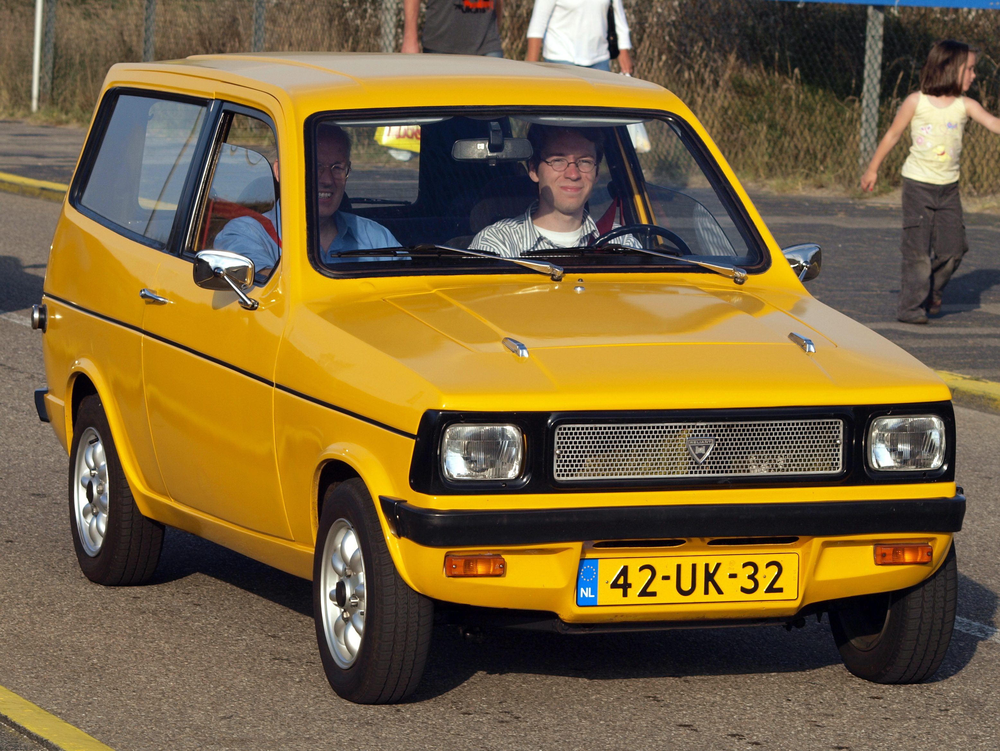

In [9]:
fig = px.imshow(img)
fig.update_layout(width=600, height=500, margin=dict(l=10, r=10, b=10, t=10),xaxis_title='Figure 8 - N2.jpeg with bounding box')
fig.add_shape(type='rect',x0=1804, x1=2493, y0=1734, y1=1882, xref='x', yref='y',line_color='cyan')

In [10]:
file_path = image_path[0] 
file_path

'C:/Users/HP/Downloads/Automatic-License-Plate-Detection-main/images/N1.jpeg'

In [11]:
# file_path='C:\\Users\\HP\\Downloads\\Automatic-License-Plate-Detection-main\\images'

In [12]:

file_path

'C:/Users/HP/Downloads/Automatic-License-Plate-Detection-main/images/N1.jpeg'

In [13]:
img = cv2.imread(file_path) #read the image

In [14]:
img

array([[[210, 214, 173],
        [215, 219, 178],
        [222, 226, 185],
        ...,
        [116, 120, 149],
        [116, 120, 149],
        [116, 120, 149]],

       [[209, 213, 172],
        [216, 220, 179],
        [227, 231, 190],
        ...,
        [128, 132, 161],
        [127, 131, 160],
        [126, 130, 159]],

       [[212, 215, 176],
        [222, 225, 186],
        [238, 241, 202],
        ...,
        [127, 129, 160],
        [125, 127, 158],
        [125, 127, 158]],

       ...,

       [[177, 203, 215],
        [173, 199, 211],
        [167, 193, 205],
        ...,
        [150, 161, 158],
        [155, 166, 163],
        [181, 192, 189]],

       [[121, 148, 162],
        [115, 142, 156],
        [107, 134, 148],
        ...,
        [108, 119, 116],
        [110, 121, 118],
        [132, 143, 140]],

       [[ 64,  93, 107],
        [ 57,  86, 100],
        [ 50,  77,  91],
        ...,
        [128, 139, 136],
        [130, 141, 138],
        [129, 140, 137]]


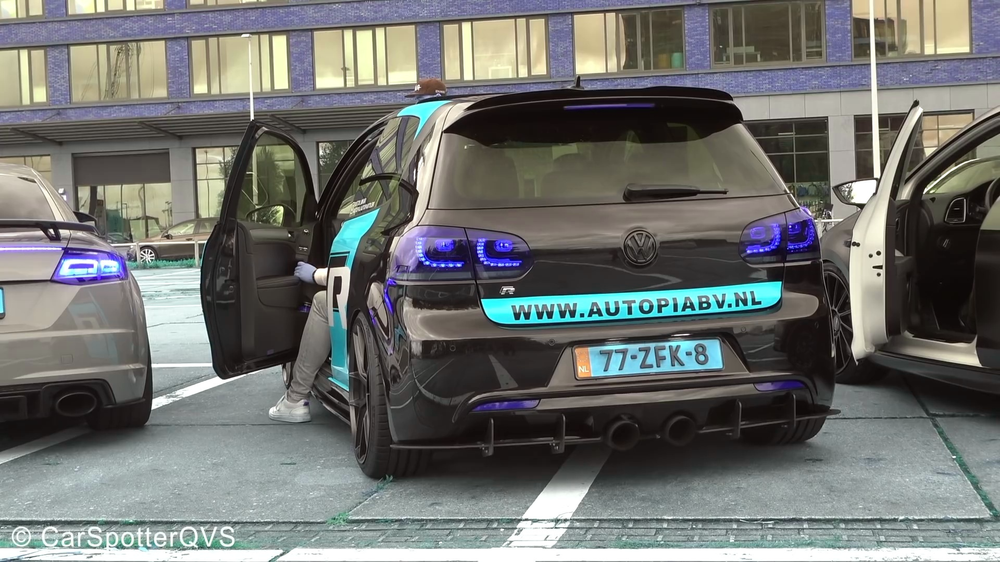

In [15]:
fig = px.imshow(img)
fig.update_layout(width=600, height=500, margin=dict(l=10, r=10, b=10, t=10),xaxis_title='Figure 8 - N2.jpeg with bounding box')
fig.add_shape(type='rect',x0=1804, x1=2493, y0=1734, y1=1882, xref='x', yref='y',line_color='cyan')


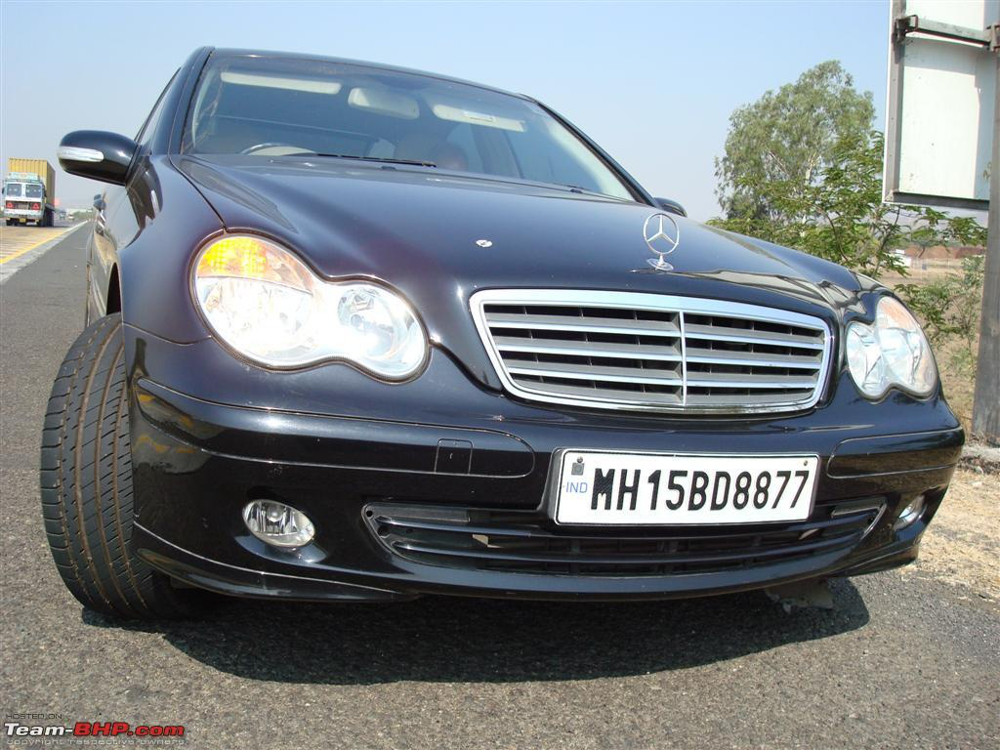

In [17]:
file_path = image_path[87] #path of our image N2.jpeg
img = cv2.imread(file_path) #read the image
# xmin-1804/ymin-1734/xmax-2493/ymax-1882 
img = io.imread(file_path) #Read the image
fig = px.imshow(img)
fig.update_layout(width=600, height=500, margin=dict(l=10, r=10, b=10, t=10),xaxis_title='Figure 8 - N2.jpeg with bounding box')
fig.add_shape(type='rect',x0=1804, x1=2493, y0=1734, y1=1882, xref='x', yref='y',line_color='cyan')

<p id="part11"></p>

# <span style="font-family: Arials; font-size: 20px; font-style: normal; font-weight: bold; letter-spacing: 3px; text-align: center; color: #000000; line-height:1.0">DATA PROCESSING</span>

<p id="part12"></p>

# <span style="font-family: Arials; font-size: 16px; font-style: normal; font-weight: bold; letter-spacing: 3px; text-align: center; color: #000000; line-height:1.0">READ DATA</span>

This is a very important step, in this process we will take each and every image and convert it into an array using OpenCV and resize the image into 224 x 224 which is the standard compatible size of the pre-trained transfer learning model.

In [23]:
#Targeting all our values in array selecting all columns
labels = df.iloc[:,1:].values
data = []
output = []
for ind in range(len(image_path)):
    image = image_path[ind]
    img_arr = cv2.imread(image)
    h,w,d = img_arr.shape
    # Prepprocesing
    load_image = load_img(image,target_size=(224,224))
    load_image_arr = img_to_array(load_image)
    norm_load_image_arr = load_image_arr/255.0 # Normalization
    # Normalization to labels
    xmin,xmax,ymin,ymax = labels[ind]
    nxmin,nxmax = xmin/w,xmax/w
    nymin,nymax = ymin/h,ymax/h
    label_norm = (nxmin,nxmax,nymin,nymax) # Normalized output
    # Append
    data.append(norm_load_image_arr)
    output.append(label_norm)



# <span style="font-family: Arials; font-size: 16px; font-style: normal; font-weight: bold; letter-spacing: 3px; text-align: center; color: #000000; line-height:1.0">SPLIT TRAIN AND TEST SET</span>
In the next step, we will convert the list into an array using __Numpy__.

In [24]:
# Convert data to array
X = np.array(data,dtype=np.float32)
y = np.array(output,dtype=np.float32)

Now split the data into training and testing set using __sklearn__.

In [ ]:
#Split the data into training and testing set using sklearn.
x_train,x_test,y_train,y_test = train_test_split(X,y,train_size=0.8,random_state=0)
x_train.shape,x_test.shape,y_train.shape,y_test.shape

# INCEPTION-RESNET-V2 MODEL BUILDING

In [26]:
inception_resnet = InceptionResNetV2(weights="imagenet",include_top=False, input_tensor=Input(shape=(224,224,3)))
# ---------------------
headmodel = inception_resnet.output
headmodel = Flatten()(headmodel)
headmodel = Dense(500,activation="relu")(headmodel)
headmodel = Dense(250,activation="relu")(headmodel)
headmodel = Dense(4,activation='sigmoid')(headmodel)


# ---------- model
model = Model(inputs=inception_resnet.input,outputs=headmodel)

Now compile the model and  have a look at our summary. Don't de surprise summary will be a bit massiv. The summary is textual and includes information about: The layers and their order in the model. The output shape of each layer. The number of parameters (weights) in each layer.

In [27]:
# Complie model
model.compile(loss='mse',optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4))
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 111, 111, 32)         864       ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 111, 111, 32)         96        ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 activation (Activation)     (None, 111, 111, 32)         0         ['batch_normalization[0][0

 conv2d_11 (Conv2D)          (None, 25, 25, 64)           12288     ['average_pooling2d[0][0]']   
                                                                                                  
 batch_normalization_5 (Bat  (None, 25, 25, 96)           288       ['conv2d_5[0][0]']            
 chNormalization)                                                                                 
                                                                                                  
 batch_normalization_7 (Bat  (None, 25, 25, 64)           192       ['conv2d_7[0][0]']            
 chNormalization)                                                                                 
                                                                                                  
 batch_normalization_10 (Ba  (None, 25, 25, 96)           288       ['conv2d_10[0][0]']           
 tchNormalization)                                                                                
          

 block35_1_conv (Conv2D)     (None, 25, 25, 320)          41280     ['block35_1_mixed[0][0]']     
                                                                                                  
 custom_scale_layer (Custom  (None, 25, 25, 320)          0         ['mixed_5b[0][0]',            
 ScaleLayer)                                                         'block35_1_conv[0][0]']      
                                                                                                  
 block35_1_ac (Activation)   (None, 25, 25, 320)          0         ['custom_scale_layer[0][0]']  
                                                                                                  
 conv2d_21 (Conv2D)          (None, 25, 25, 32)           10240     ['block35_1_ac[0][0]']        
                                                                                                  
 batch_normalization_21 (Ba  (None, 25, 25, 32)           96        ['conv2d_21[0][0]']           
 tchNormal

                                                                                                  
 activation_25 (Activation)  (None, 25, 25, 32)           0         ['batch_normalization_25[0][0]
                                                                    ']                            
                                                                                                  
 activation_28 (Activation)  (None, 25, 25, 48)           0         ['batch_normalization_28[0][0]
                                                                    ']                            
                                                                                                  
 conv2d_24 (Conv2D)          (None, 25, 25, 32)           10240     ['block35_2_ac[0][0]']        
                                                                                                  
 conv2d_26 (Conv2D)          (None, 25, 25, 32)           9216      ['activation_25[0][0]']       
          

                                                                                                  
 activation_32 (Activation)  (None, 25, 25, 32)           0         ['batch_normalization_32[0][0]
                                                                    ']                            
                                                                                                  
 activation_35 (Activation)  (None, 25, 25, 64)           0         ['batch_normalization_35[0][0]
                                                                    ']                            
                                                                                                  
 block35_4_mixed (Concatena  (None, 25, 25, 128)          0         ['activation_30[0][0]',       
 te)                                                                 'activation_32[0][0]',       
                                                                     'activation_35[0][0]']       
          

                                                                    ']                            
                                                                                                  
 conv2d_43 (Conv2D)          (None, 25, 25, 32)           10240     ['block35_5_ac[0][0]']        
                                                                                                  
 conv2d_46 (Conv2D)          (None, 25, 25, 48)           13824     ['activation_45[0][0]']       
                                                                                                  
 batch_normalization_43 (Ba  (None, 25, 25, 32)           96        ['conv2d_43[0][0]']           
 tchNormalization)                                                                                
                                                                                                  
 batch_normalization_46 (Ba  (None, 25, 25, 48)           144       ['conv2d_46[0][0]']           
 tchNormal

 batch_normalization_48 (Ba  (None, 25, 25, 32)           96        ['conv2d_48[0][0]']           
 tchNormalization)                                                                                
                                                                                                  
 batch_normalization_50 (Ba  (None, 25, 25, 32)           96        ['conv2d_50[0][0]']           
 tchNormalization)                                                                                
                                                                                                  
 batch_normalization_53 (Ba  (None, 25, 25, 64)           192       ['conv2d_53[0][0]']           
 tchNormalization)                                                                                
                                                                                                  
 activation_48 (Activation)  (None, 25, 25, 32)           0         ['batch_normalization_48[0][0]
          

 custom_scale_layer_7 (Cust  (None, 25, 25, 320)          0         ['block35_7_ac[0][0]',        
 omScaleLayer)                                                       'block35_8_conv[0][0]']      
                                                                                                  
 block35_8_ac (Activation)   (None, 25, 25, 320)          0         ['custom_scale_layer_7[0][0]']
                                                                                                  
 conv2d_63 (Conv2D)          (None, 25, 25, 32)           10240     ['block35_8_ac[0][0]']        
                                                                                                  
 batch_normalization_63 (Ba  (None, 25, 25, 32)           96        ['conv2d_63[0][0]']           
 tchNormalization)                                                                                
                                                                                                  
 activatio

                                                                    ']                            
                                                                                                  
 activation_70 (Activation)  (None, 25, 25, 48)           0         ['batch_normalization_70[0][0]
                                                                    ']                            
                                                                                                  
 conv2d_66 (Conv2D)          (None, 25, 25, 32)           10240     ['block35_9_ac[0][0]']        
                                                                                                  
 conv2d_68 (Conv2D)          (None, 25, 25, 32)           9216      ['activation_67[0][0]']       
                                                                                                  
 conv2d_71 (Conv2D)          (None, 25, 25, 64)           27648     ['activation_70[0][0]']       
          

                                                                                                  
 activation_77 (Activation)  (None, 12, 12, 128)          0         ['batch_normalization_77[0][0]
                                                                    ']                            
                                                                                                  
 conv2d_78 (Conv2D)          (None, 12, 12, 160)          143360    ['activation_77[0][0]']       
                                                                                                  
 batch_normalization_78 (Ba  (None, 12, 12, 160)          480       ['conv2d_78[0][0]']           
 tchNormalization)                                                                                
                                                                                                  
 activation_78 (Activation)  (None, 12, 12, 160)          0         ['batch_normalization_78[0][0]
          

                                                                                                  
 batch_normalization_85 (Ba  (None, 12, 12, 128)          384       ['conv2d_85[0][0]']           
 tchNormalization)                                                                                
                                                                                                  
 activation_85 (Activation)  (None, 12, 12, 128)          0         ['batch_normalization_85[0][0]
                                                                    ']                            
                                                                                                  
 conv2d_86 (Conv2D)          (None, 12, 12, 160)          143360    ['activation_85[0][0]']       
                                                                                                  
 batch_normalization_86 (Ba  (None, 12, 12, 160)          480       ['conv2d_86[0][0]']           
 tchNormal

                                                                    ]                             
                                                                                                  
 conv2d_93 (Conv2D)          (None, 12, 12, 128)          139264    ['block17_4_ac[0][0]']        
                                                                                                  
 batch_normalization_93 (Ba  (None, 12, 12, 128)          384       ['conv2d_93[0][0]']           
 tchNormalization)                                                                                
                                                                                                  
 activation_93 (Activation)  (None, 12, 12, 128)          0         ['batch_normalization_93[0][0]
                                                                    ']                            
                                                                                                  
 conv2d_94

 tomScaleLayer)                                                      'block17_6_conv[0][0]']      
                                                                                                  
 block17_6_ac (Activation)   (None, 12, 12, 1088)         0         ['custom_scale_layer_15[0][0]'
                                                                    ]                             
                                                                                                  
 conv2d_101 (Conv2D)         (None, 12, 12, 128)          139264    ['block17_6_ac[0][0]']        
                                                                                                  
 batch_normalization_101 (B  (None, 12, 12, 128)          384       ['conv2d_101[0][0]']          
 atchNormalization)                                                                               
                                                                                                  
 activatio

 block17_8_conv (Conv2D)     (None, 12, 12, 1088)         418880    ['block17_8_mixed[0][0]']     
                                                                                                  
 custom_scale_layer_17 (Cus  (None, 12, 12, 1088)         0         ['block17_7_ac[0][0]',        
 tomScaleLayer)                                                      'block17_8_conv[0][0]']      
                                                                                                  
 block17_8_ac (Activation)   (None, 12, 12, 1088)         0         ['custom_scale_layer_17[0][0]'
                                                                    ]                             
                                                                                                  
 conv2d_109 (Conv2D)         (None, 12, 12, 128)          139264    ['block17_8_ac[0][0]']        
                                                                                                  
 batch_nor

 block17_10_mixed (Concaten  (None, 12, 12, 384)          0         ['activation_112[0][0]',      
 ate)                                                                'activation_115[0][0]']      
                                                                                                  
 block17_10_conv (Conv2D)    (None, 12, 12, 1088)         418880    ['block17_10_mixed[0][0]']    
                                                                                                  
 custom_scale_layer_19 (Cus  (None, 12, 12, 1088)         0         ['block17_9_ac[0][0]',        
 tomScaleLayer)                                                      'block17_10_conv[0][0]']     
                                                                                                  
 block17_10_ac (Activation)  (None, 12, 12, 1088)         0         ['custom_scale_layer_19[0][0]'
                                                                    ]                             
          

 activation_123 (Activation  (None, 12, 12, 192)          0         ['batch_normalization_123[0][0
 )                                                                  ]']                           
                                                                                                  
 block17_12_mixed (Concaten  (None, 12, 12, 384)          0         ['activation_120[0][0]',      
 ate)                                                                'activation_123[0][0]']      
                                                                                                  
 block17_12_conv (Conv2D)    (None, 12, 12, 1088)         418880    ['block17_12_mixed[0][0]']    
                                                                                                  
 custom_scale_layer_21 (Cus  (None, 12, 12, 1088)         0         ['block17_11_ac[0][0]',       
 tomScaleLayer)                                                      'block17_12_conv[0][0]']     
          

 activation_128 (Activation  (None, 12, 12, 192)          0         ['batch_normalization_128[0][0
 )                                                                  ]']                           
                                                                                                  
 activation_131 (Activation  (None, 12, 12, 192)          0         ['batch_normalization_131[0][0
 )                                                                  ]']                           
                                                                                                  
 block17_14_mixed (Concaten  (None, 12, 12, 384)          0         ['activation_128[0][0]',      
 ate)                                                                'activation_131[0][0]']      
                                                                                                  
 block17_14_conv (Conv2D)    (None, 12, 12, 1088)         418880    ['block17_14_mixed[0][0]']    
          

 batch_normalization_139 (B  (None, 12, 12, 192)          576       ['conv2d_139[0][0]']          
 atchNormalization)                                                                               
                                                                                                  
 activation_136 (Activation  (None, 12, 12, 192)          0         ['batch_normalization_136[0][0
 )                                                                  ]']                           
                                                                                                  
 activation_139 (Activation  (None, 12, 12, 192)          0         ['batch_normalization_139[0][0
 )                                                                  ]']                           
                                                                                                  
 block17_16_mixed (Concaten  (None, 12, 12, 384)          0         ['activation_136[0][0]',      
 ate)     

 batch_normalization_144 (B  (None, 12, 12, 192)          576       ['conv2d_144[0][0]']          
 atchNormalization)                                                                               
                                                                                                  
 batch_normalization_147 (B  (None, 12, 12, 192)          576       ['conv2d_147[0][0]']          
 atchNormalization)                                                                               
                                                                                                  
 activation_144 (Activation  (None, 12, 12, 192)          0         ['batch_normalization_144[0][0
 )                                                                  ]']                           
                                                                                                  
 activation_147 (Activation  (None, 12, 12, 192)          0         ['batch_normalization_147[0][0
 )        

                                                                                                  
 conv2d_155 (Conv2D)         (None, 12, 12, 192)          215040    ['activation_154[0][0]']      
                                                                                                  
 batch_normalization_152 (B  (None, 12, 12, 192)          576       ['conv2d_152[0][0]']          
 atchNormalization)                                                                               
                                                                                                  
 batch_normalization_155 (B  (None, 12, 12, 192)          576       ['conv2d_155[0][0]']          
 atchNormalization)                                                                               
                                                                                                  
 activation_152 (Activation  (None, 12, 12, 192)          0         ['batch_normalization_152[0][0
 )        

 g2D)                                                                                             
                                                                                                  
 mixed_7a (Concatenate)      (None, 5, 5, 2080)           0         ['activation_157[0][0]',      
                                                                     'activation_159[0][0]',      
                                                                     'activation_162[0][0]',      
                                                                     'max_pooling2d_3[0][0]']     
                                                                                                  
 conv2d_164 (Conv2D)         (None, 5, 5, 192)            399360    ['mixed_7a[0][0]']            
                                                                                                  
 batch_normalization_164 (B  (None, 5, 5, 192)            576       ['conv2d_164[0][0]']          
 atchNorma

 e)                                                                  'activation_170[0][0]']      
                                                                                                  
 block8_2_conv (Conv2D)      (None, 5, 5, 2080)           933920    ['block8_2_mixed[0][0]']      
                                                                                                  
 custom_scale_layer_31 (Cus  (None, 5, 5, 2080)           0         ['block8_1_ac[0][0]',         
 tomScaleLayer)                                                      'block8_2_conv[0][0]']       
                                                                                                  
 block8_2_ac (Activation)    (None, 5, 5, 2080)           0         ['custom_scale_layer_31[0][0]'
                                                                    ]                             
                                                                                                  
 conv2d_17

 )                                                                  ]']                           
                                                                                                  
 block8_4_mixed (Concatenat  (None, 5, 5, 448)            0         ['activation_175[0][0]',      
 e)                                                                  'activation_178[0][0]']      
                                                                                                  
 block8_4_conv (Conv2D)      (None, 5, 5, 2080)           933920    ['block8_4_mixed[0][0]']      
                                                                                                  
 custom_scale_layer_33 (Cus  (None, 5, 5, 2080)           0         ['block8_3_ac[0][0]',         
 tomScaleLayer)                                                      'block8_4_conv[0][0]']       
                                                                                                  
 block8_4_

 )                                                                  ]']                           
                                                                                                  
 activation_186 (Activation  (None, 5, 5, 256)            0         ['batch_normalization_186[0][0
 )                                                                  ]']                           
                                                                                                  
 block8_6_mixed (Concatenat  (None, 5, 5, 448)            0         ['activation_183[0][0]',      
 e)                                                                  'activation_186[0][0]']      
                                                                                                  
 block8_6_conv (Conv2D)      (None, 5, 5, 2080)           933920    ['block8_6_mixed[0][0]']      
                                                                                                  
 custom_sc

 atchNormalization)                                                                               
                                                                                                  
 activation_191 (Activation  (None, 5, 5, 192)            0         ['batch_normalization_191[0][0
 )                                                                  ]']                           
                                                                                                  
 activation_194 (Activation  (None, 5, 5, 256)            0         ['batch_normalization_194[0][0
 )                                                                  ]']                           
                                                                                                  
 block8_8_mixed (Concatenat  (None, 5, 5, 448)            0         ['activation_191[0][0]',      
 e)                                                                  'activation_194[0][0]']      
          

 atchNormalization)                                                                               
                                                                                                  
 batch_normalization_202 (B  (None, 5, 5, 256)            768       ['conv2d_202[0][0]']          
 atchNormalization)                                                                               
                                                                                                  
 activation_199 (Activation  (None, 5, 5, 192)            0         ['batch_normalization_199[0][0
 )                                                                  ]']                           
                                                                                                  
 activation_202 (Activation  (None, 5, 5, 256)            0         ['batch_normalization_202[0][0
 )                                                                  ]']                           
          

<p id="part16"></p>

# <span style="font-family: Arials; font-size: 16px; font-style: normal; font-weight: bold; letter-spacing: 3px; text-align: center; color: #000000; line-height:1.0"> INCEPTION-RESNET-V2 TRAINING AND SAVE</span>

In [28]:
tfb = TensorBoard('object_detection')

In [29]:
history = model.fit(x=x_train,y=y_train,batch_size=10,epochs=10,
                    validation_data=(x_test,y_test),callbacks=[tfb])

Epoch 1/10
18/18 [==============================] - 116s 4s/step - loss: 0.0667 - val_loss: 0.0560
Epoch 2/10
18/18 [==============================] - 75s 4s/step - loss: 0.0442 - val_loss: 0.0466
Epoch 3/10
18/18 [==============================] - 73s 4s/step - loss: 0.0317 - val_loss: 0.0200
Epoch 4/10
18/18 [==============================] - 73s 4s/step - loss: 0.0111 - val_loss: 0.0103
Epoch 5/10
18/18 [==============================] - 71s 4s/step - loss: 0.0087 - val_loss: 0.0105
Epoch 6/10
18/18 [==============================] - 71s 4s/step - loss: 0.0055 - val_loss: 0.0080
Epoch 7/10
18/18 [==============================] - 71s 4s/step - loss: 0.0036 - val_loss: 0.0075
Epoch 8/10
18/18 [==============================] - 76s 4s/step - loss: 0.0032 - val_loss: 0.0077
Epoch 9/10
18/18 [==============================] - 76s 4s/step - loss: 0.0026 - val_loss: 0.0066
Epoch 10/10
18/18 [==============================] - 82s 5s/step - loss: 0.0017 - val_loss: 0.0070


In [30]:
model.save('./object_detection.h5')

C:\Users\HP\anaconda3\Lib\site-packages\keras\src\engine\training.py:3000: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



# PIPELINE OBJECT DETECTION MODEL - MAKE PREDICTIONS

In [31]:
# Load model
model = tf.keras.models.load_model('./object_detection.h5')
print('Model loaded Sucessfully')

Model loaded Sucessfully


In [34]:
path = 'C:/Users/HP/Downloads/Automatic-License-Plate-Detection-main/TEST/TEST1.png'
image = load_img(path) # PIL object
image = np.array(image,dtype=np.uint8) # 8 bit array (0,255)
image1 = load_img(path,target_size=(224,224))
image_arr_224 = img_to_array(image1)/255.0  # Convert into array and get the normalized output

# Size of the orginal image
h,w,d = image.shape
print('Height of the image =',h)
print('Width of the image =',w)


Height of the image = 742
Width of the image = 1200


Now we can have a look at our image *Figure 13*


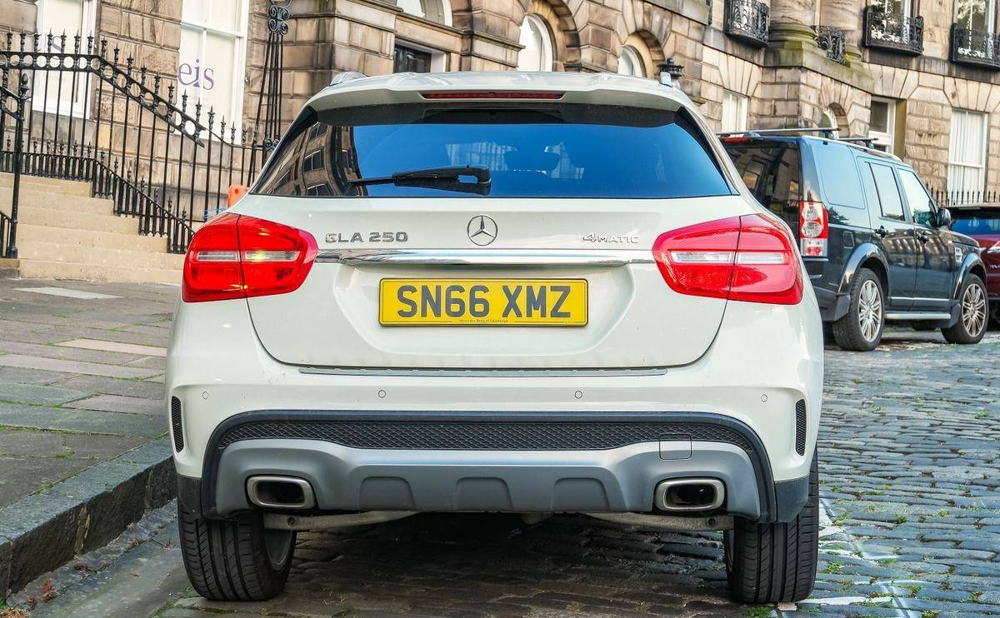

In [35]:
fig = px.imshow(image)
fig.update_layout(width=700, height=500,  margin=dict(l=10, r=10, b=10, t=10), xaxis_title='Figure 13 - TEST Image')

So, let's look into the shape of my image.

In [36]:
image_arr_224.shape

(224, 224, 3)

But in order to pass this image of a model, we need to provide the data in the dynamic fourth dimension. And what one indicates is a number of images. So here we are just passing only one image.

In [37]:
test_arr = image_arr_224.reshape(1,224,224,3)
test_arr.shape

(1, 224, 224, 3)

<p id="part20"></p>

# <span style="font-family: Arials; font-size: 16px; font-style: normal; font-weight: bold; letter-spacing: 3px; text-align: center; color: #000000; line-height:1.0">DE-NORMALIZE THE OUTPUT</span>

In [38]:
# Make predictions
coords = model.predict(test_arr)
coords

1/1 [==============================] - 3s 3s/step


array([[0.39426857, 0.56245416, 0.4677589 , 0.56056345]], dtype=float32)

We have got the output from the model and output what we got is the normalized output. So, what we need to do is to convert back into our original form values, which actually we did in during the training process, in the training process, we have the original form values and convert that normalized one. So basically, we will de-normalize the values back.

In [39]:
# Denormalize the values
denorm = np.array([w,w,h,h])
coords = coords * denorm
coords

array([[473.1222868 , 674.94499683, 347.07709932, 415.93807626]])

<p id="part21"></p>

# <span style="font-family: Arials; font-size: 16px; font-style: normal; font-weight: bold; letter-spacing: 3px; text-align: center; color: #000000; line-height:1.0"> BOUNDING BOX</span>

Now we will draw bounding box on top of the image. I just want to provide the two diagonal points. Let's make use of these points and let's draw the rectangle box.

In [40]:
coords = coords.astype(np.int32)
coords

array([[473, 674, 347, 415]])

In [41]:
# Draw bounding on top the image
xmin, xmax,ymin,ymax = coords[0]
pt1 =(xmin,ymin)
pt2 =(xmax,ymax)
print(pt1, pt2)

(473, 347) (674, 415)



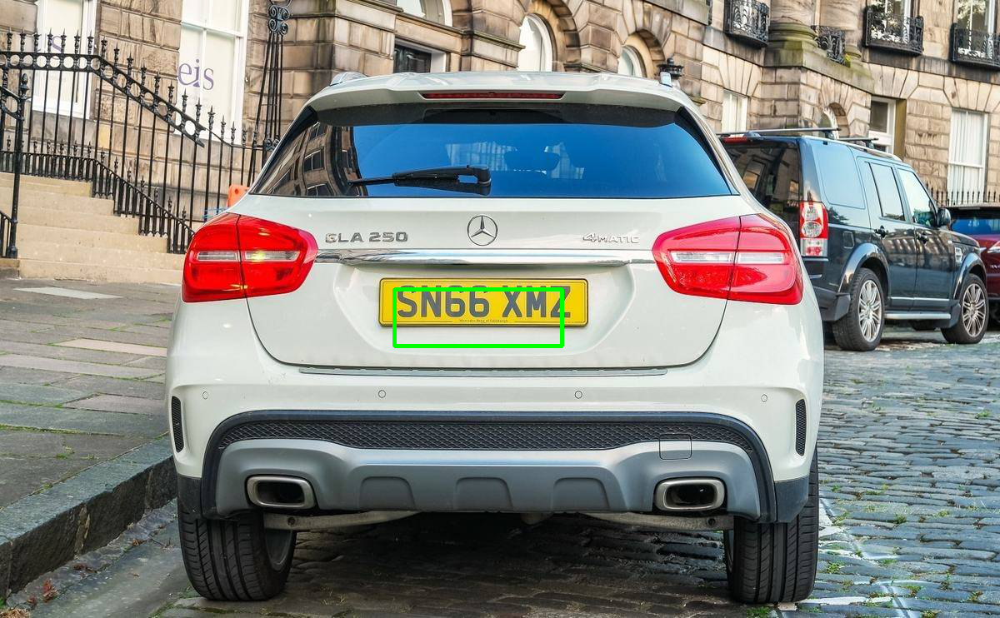

In [42]:
cv2.rectangle(image,pt1,pt2,(0,255,0),3)
fig = px.imshow(image)
fig.update_layout(width=700, height=500, margin=dict(l=10, r=10, b=10, t=10))